In [1]:
from diffusers import StableDiffusionImg2ImgPipeline, StableDiffusionPipeline
import torch
from PIL import Image
from IPython.display import display


init_image_path = "start.png"
init_image = Image.open(init_image_path).convert("RGB")

def load_model(model_path, init_image):
    if init_image:
        pipe = StableDiffusionImg2ImgPipeline.from_pretrained(model_path, torch_dtype=torch.float16)
    else:
        pipe = StableDiffusionPipeline.from_pretrained(model_path, torch_dtype=torch.float16)
    
    pipe.safety_checker = None
    pipe = pipe.to("cuda")
    return pipe


def render(pipe, prompt,init_file_image_path="", negative=""):
    if init_file_image_path != "":
        init_image_file = Image.open(init_file_image_path).convert("RGB")
        res = pipe(
                    prompt=prompt,
                    image=init_image_file,
                    strength=1.0,  # Controlla quanto l'output differisce dall'immagine originale
                    guidance_scale=2.5,  # Controlla quanto il modello segue il prompt
                    num_inference_steps=50,
                    negative_prompt=negative
                )
    else:
        res = pipe(
                    prompt=prompt,
                    #image=init_image_file,
                    strength=1.0,  # Controlla quanto l'output differisce dall'immagine originale
                    guidance_scale=2.5,  # Controlla quanto il modello segue il prompt
                    num_inference_steps=50,
                    negative_prompt=negative
                )

    tokenizer=pipe.tokenizer
    print(prompt)
    print(tokenizer.tokenize(prompt))
    display(res.images[0])


## Model without tokens (left is the right from the prospective of the object)

dataset used: 
https://huggingface.co/datasets/AdrianoC/rubber-duck

In [2]:
prospective = [
    "Top",
    "Right Top",
    "Back Right Top",
    "Back Top",
    "Back Left Top",
    "Left Top",
    "Front Left Top",
    "Front Top",
    "Front Right Top",
    "Right",
    "Back Right",
    "Back",
    "Back Left",
    "Left",
    "Front Left",
    "Front",
    "Front Right"
]

def render_all_list(pipe):
    for perspective in prospective:
        prompt = f"an image of a yellow rubber duck seen from {perspective}"
        render(pipe, prompt,init_image_path)

In [3]:
def render_all_list_no_start_image(pipe):
    for perspective in prospective:
        prompt = f"an image of a dog seen from {perspective}"
        render(pipe, prompt)
        prompt = f"an image of a car seen from {perspective}"
        render(pipe, prompt)

## Original

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'top</w>']


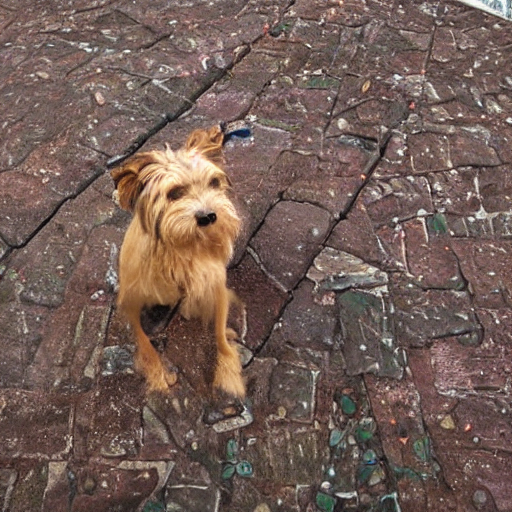

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'top</w>']


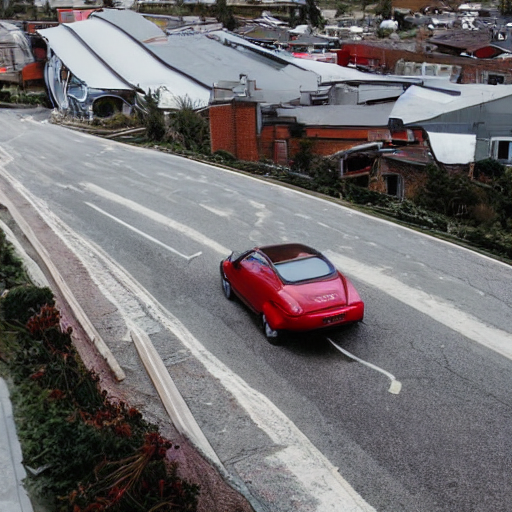

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'right</w>', 'top</w>']


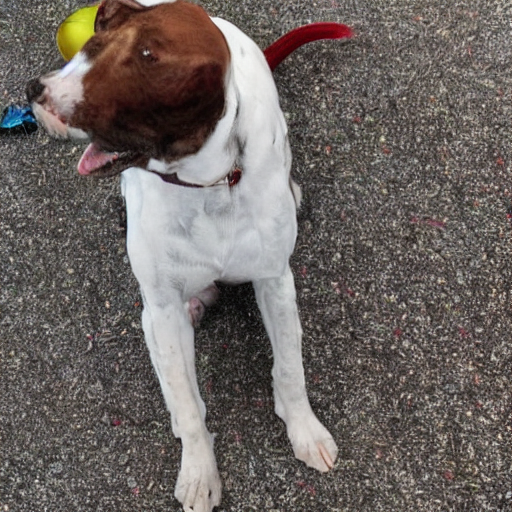

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'right</w>', 'top</w>']


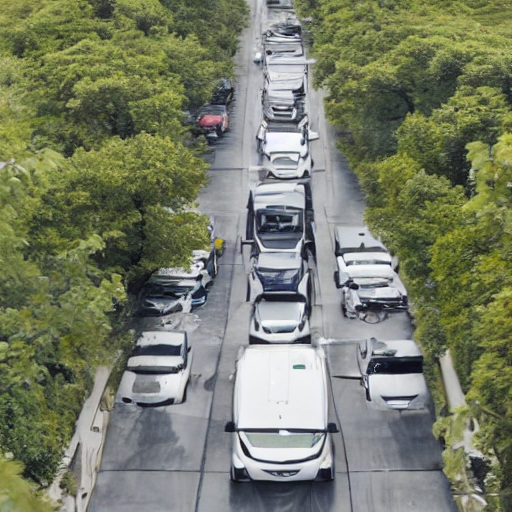

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Back Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'back</w>', 'right</w>', 'top</w>']


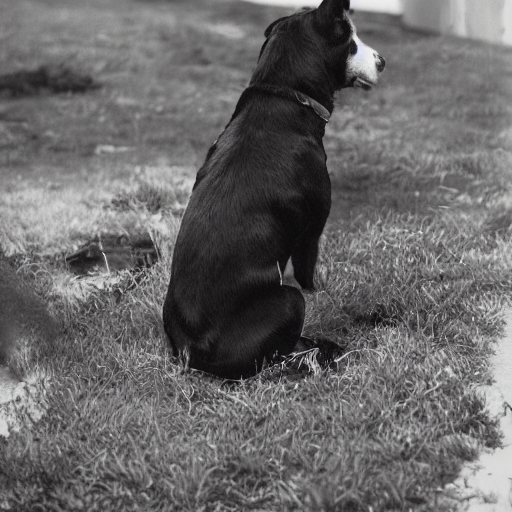

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Back Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'back</w>', 'right</w>', 'top</w>']


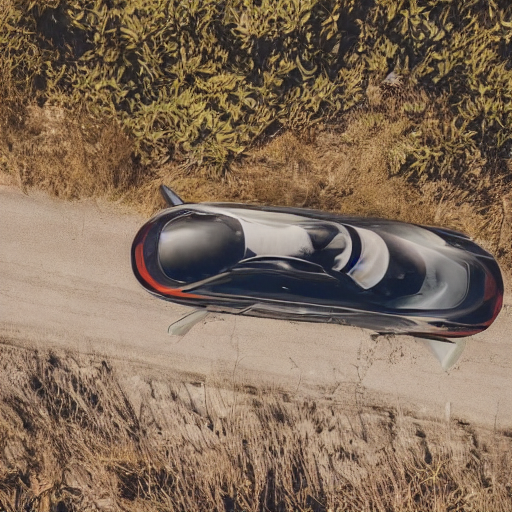

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Back Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'back</w>', 'top</w>']


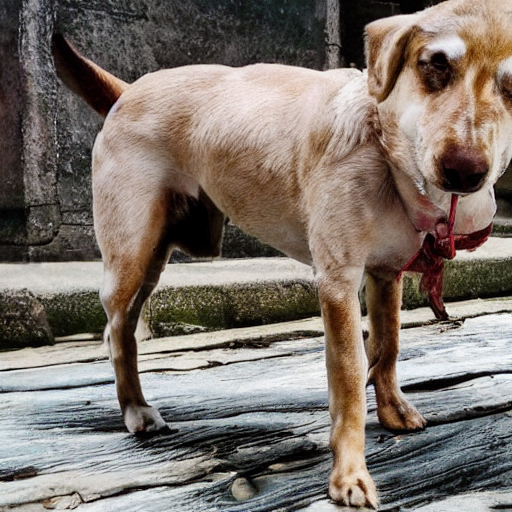

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Back Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'back</w>', 'top</w>']


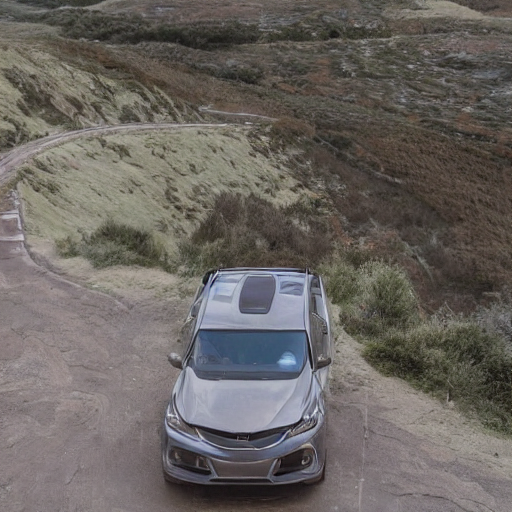

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Back Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'back</w>', 'left</w>', 'top</w>']


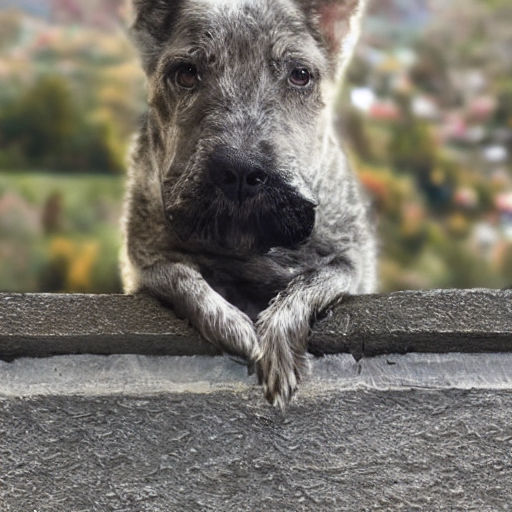

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Back Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'back</w>', 'left</w>', 'top</w>']


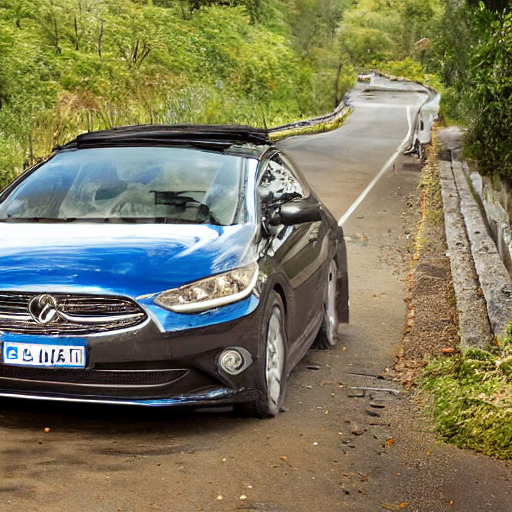

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'left</w>', 'top</w>']


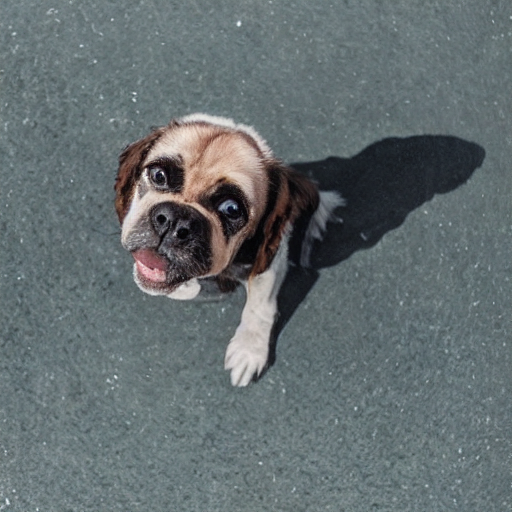

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'left</w>', 'top</w>']


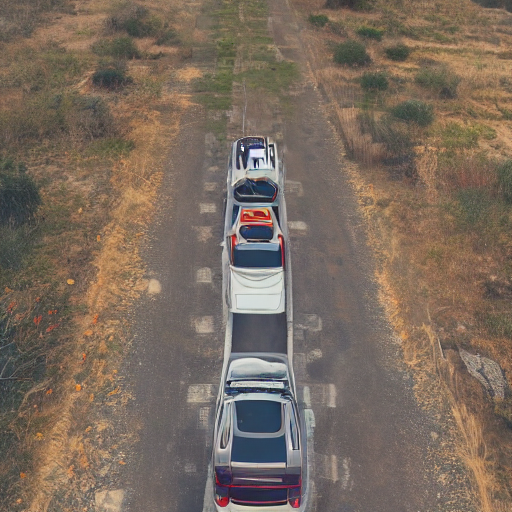

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Front Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'front</w>', 'left</w>', 'top</w>']


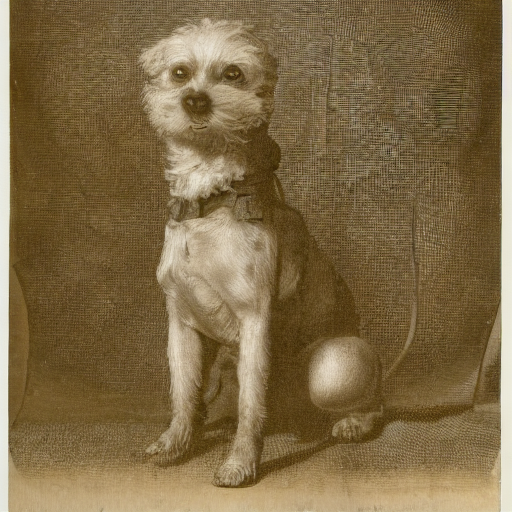

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Front Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'front</w>', 'left</w>', 'top</w>']


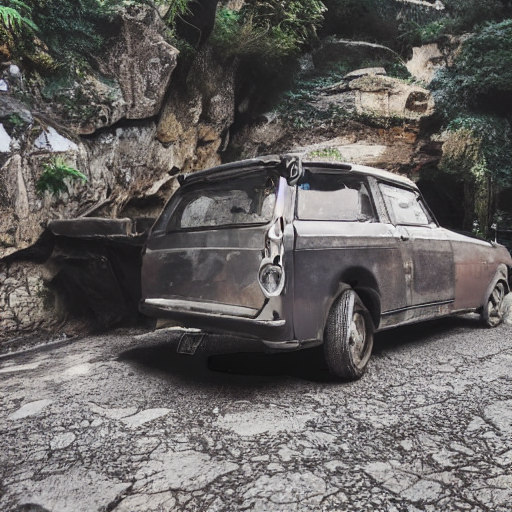

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Front Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'front</w>', 'top</w>']


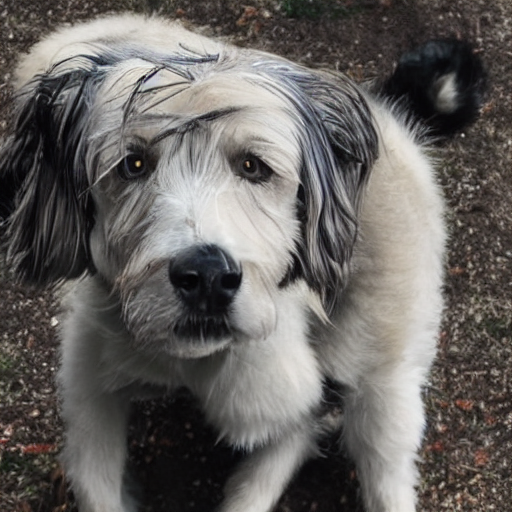

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Front Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'front</w>', 'top</w>']


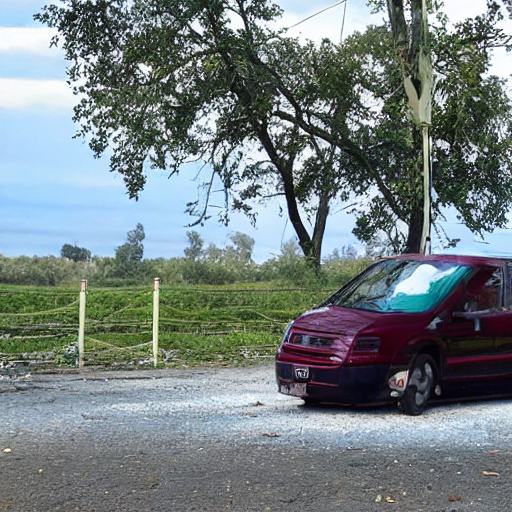

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Front Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'front</w>', 'right</w>', 'top</w>']


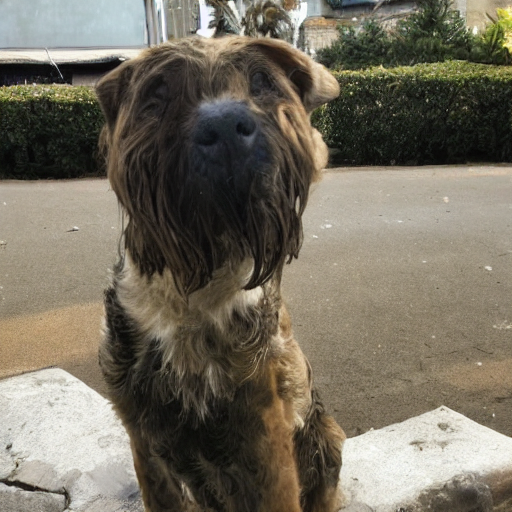

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Front Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'front</w>', 'right</w>', 'top</w>']


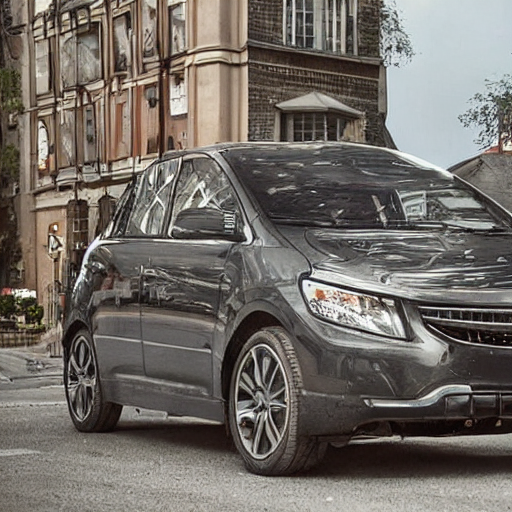

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'right</w>']


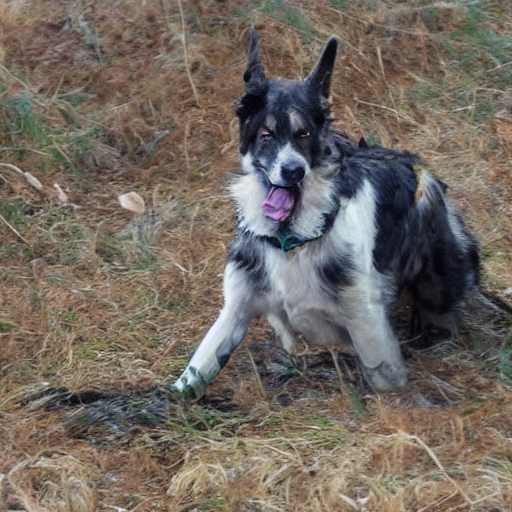

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'right</w>']


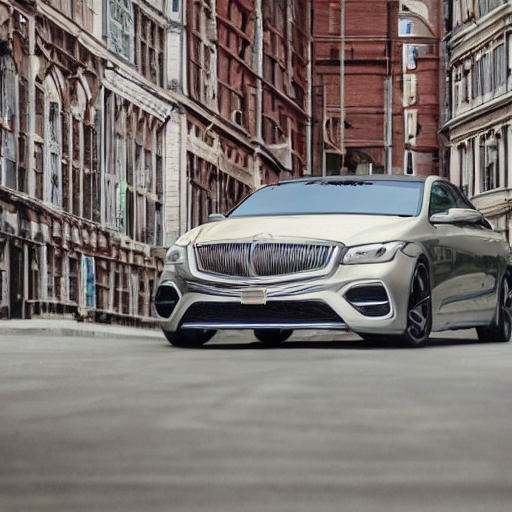

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Back Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'back</w>', 'right</w>']


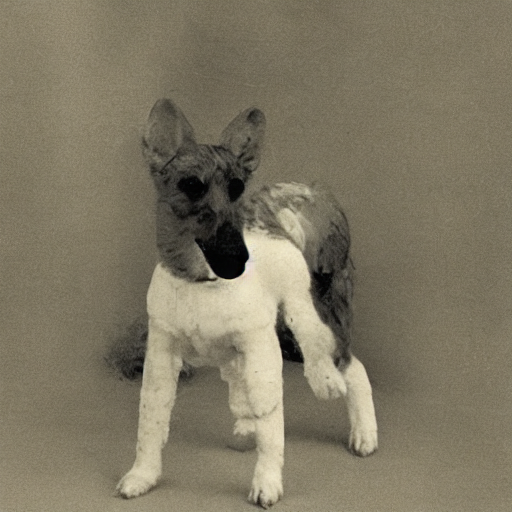

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Back Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'back</w>', 'right</w>']


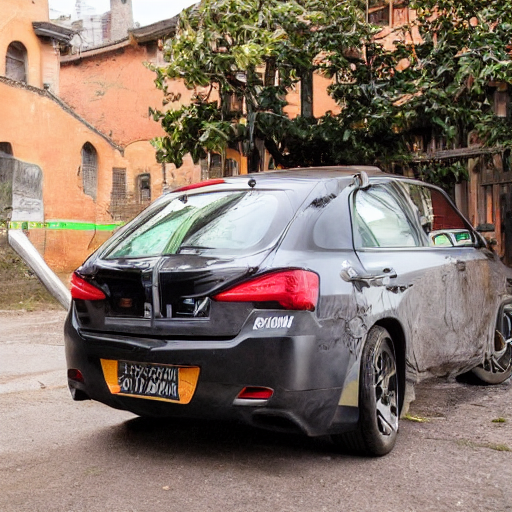

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Back
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'back</w>']


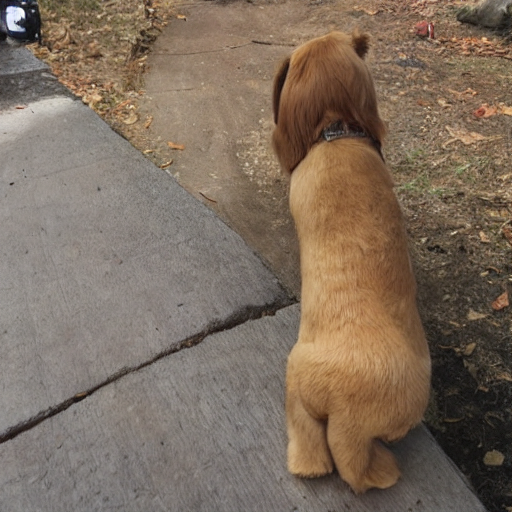

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Back
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'back</w>']


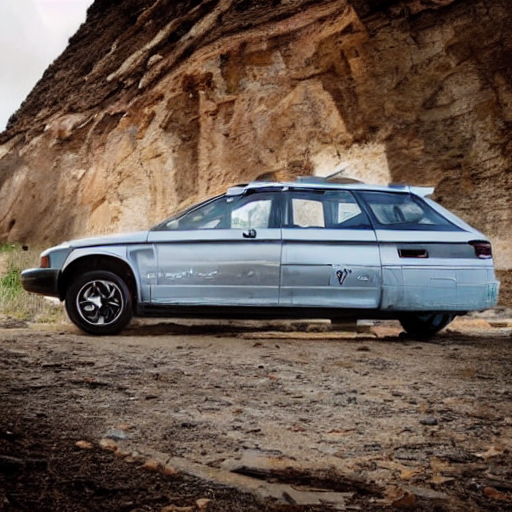

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Back Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'back</w>', 'left</w>']


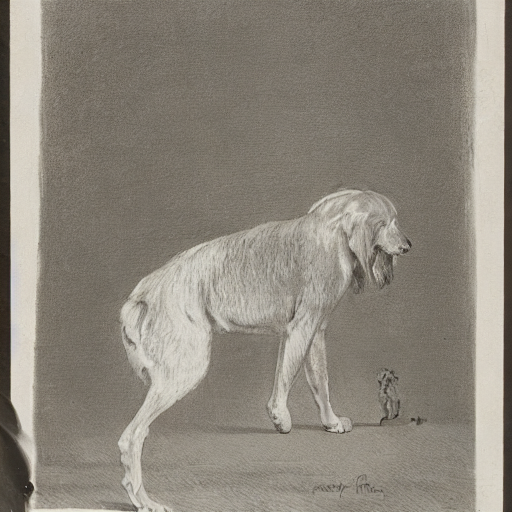

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Back Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'back</w>', 'left</w>']


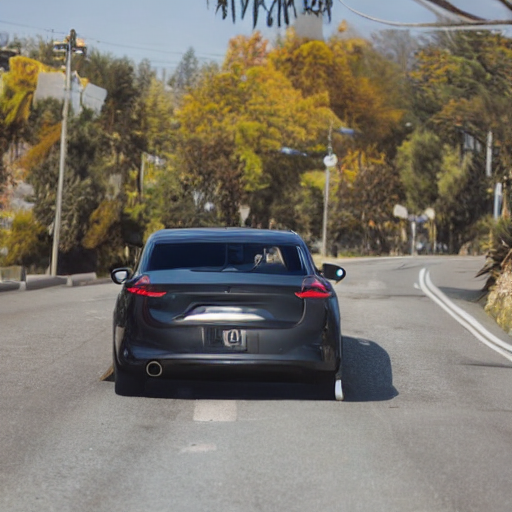

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'left</w>']


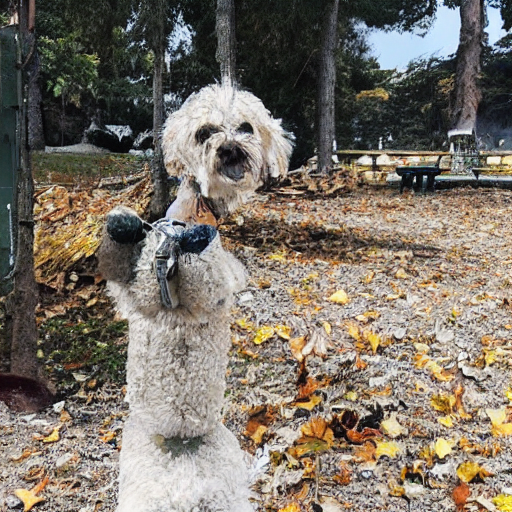

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'left</w>']


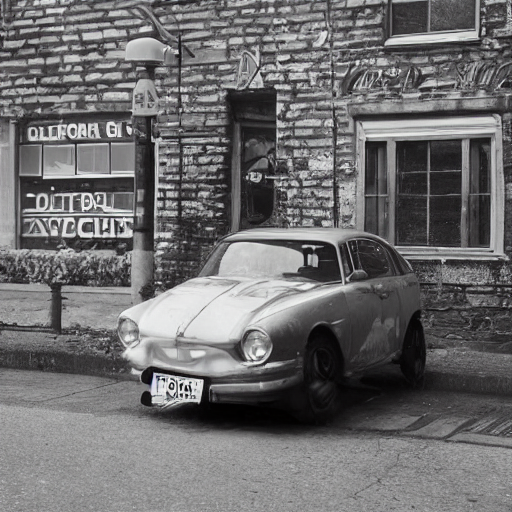

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Front Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'front</w>', 'left</w>']


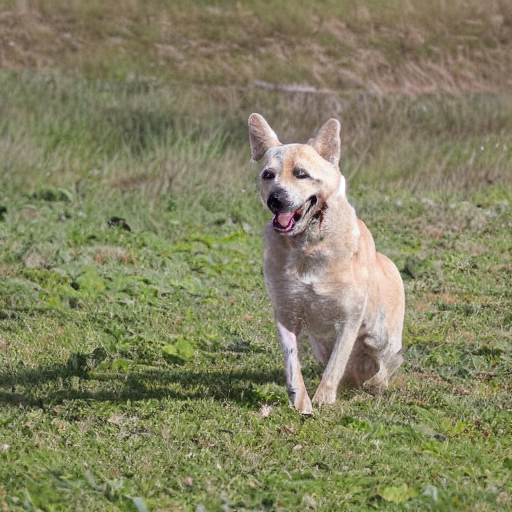

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Front Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'front</w>', 'left</w>']


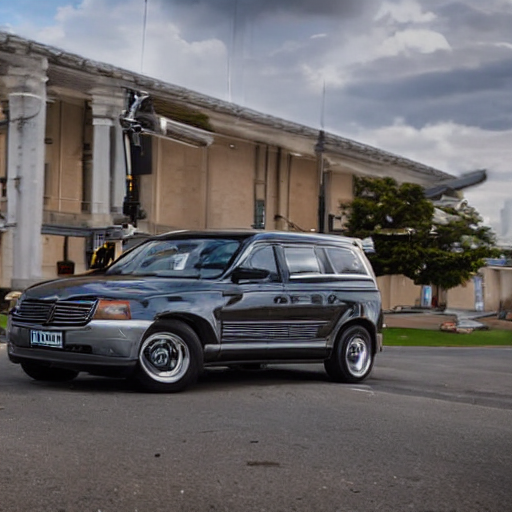

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Front
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'front</w>']


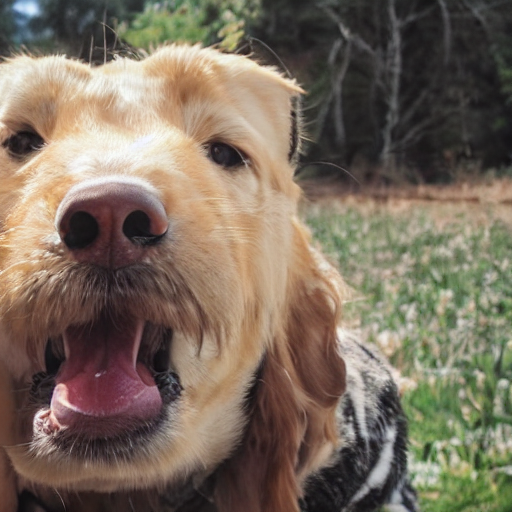

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Front
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'front</w>']


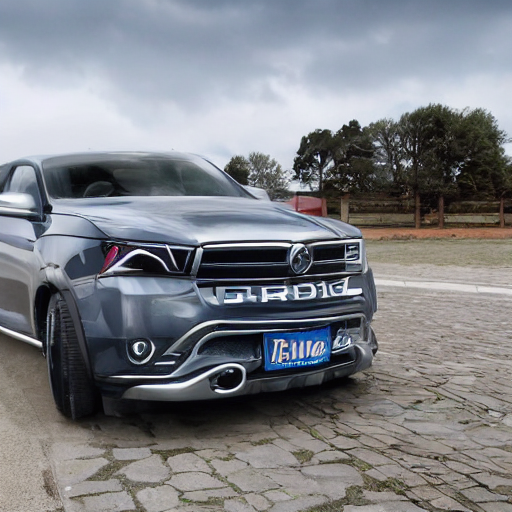

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a dog seen from Front Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'dog</w>', 'seen</w>', 'from</w>', 'front</w>', 'right</w>']


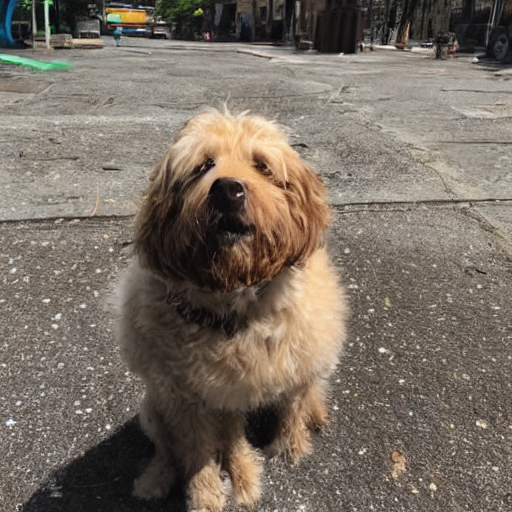

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a car seen from Front Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'car</w>', 'seen</w>', 'from</w>', 'front</w>', 'right</w>']


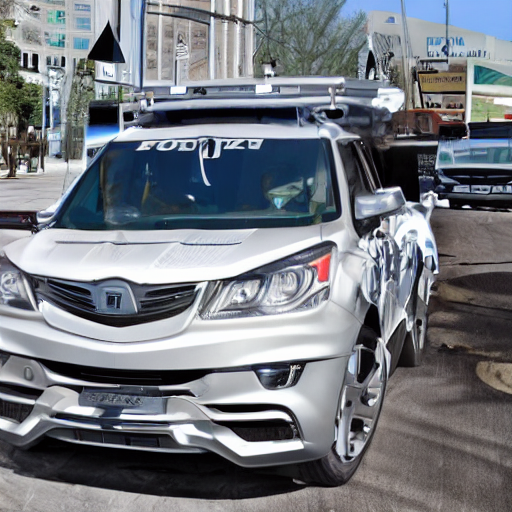

: 

In [ ]:
model_path="stable-diffusion-v1-5/stable-diffusion-v1-5"
pipe = load_model(model_path, False)
render_all_list_no_start_image(pipe)

### 30 epochs

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'top</w>']


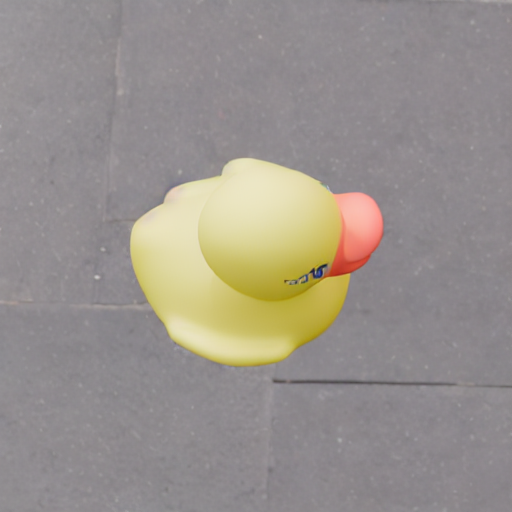

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'right</w>', 'top</w>']


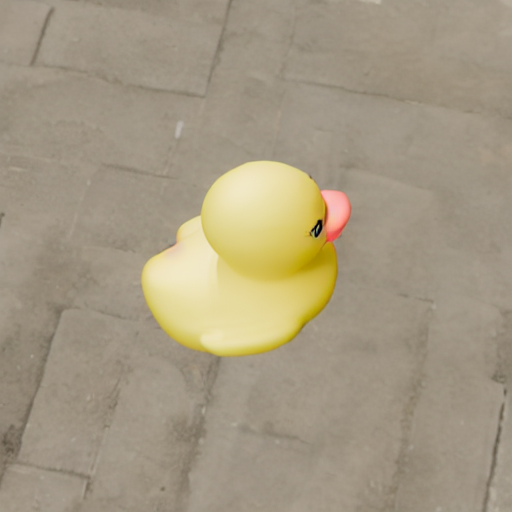

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Back Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'back</w>', 'right</w>', 'top</w>']


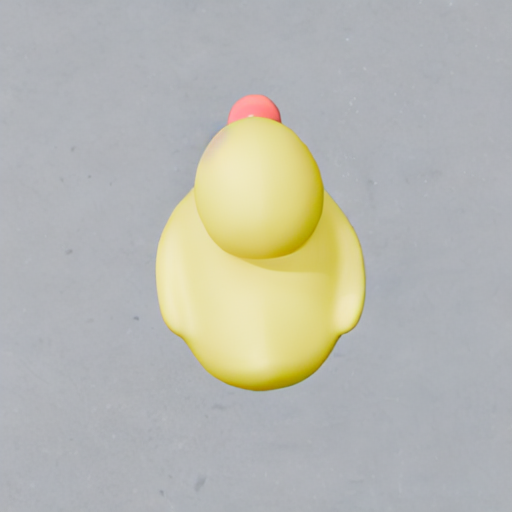

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Back Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'back</w>', 'top</w>']


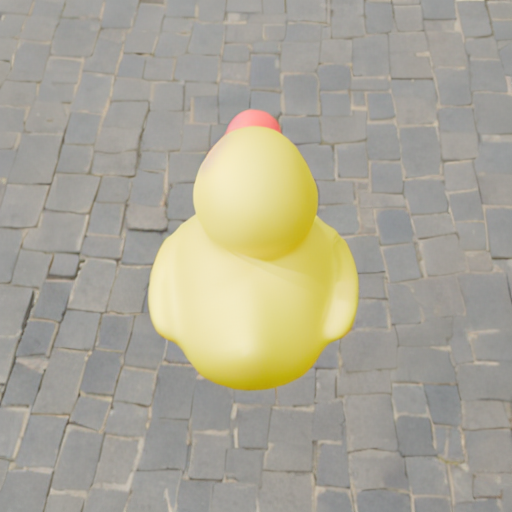

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Back Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'back</w>', 'left</w>', 'top</w>']


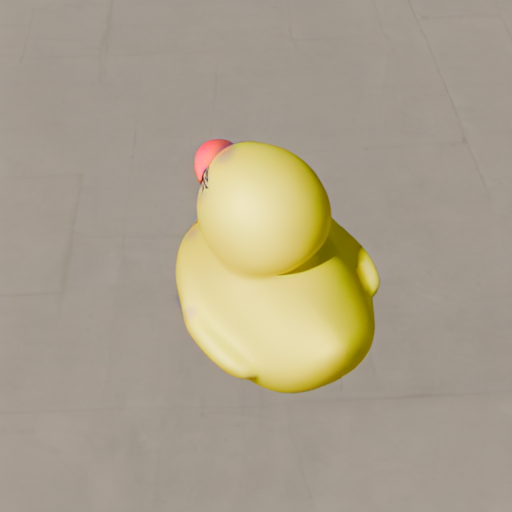

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'left</w>', 'top</w>']


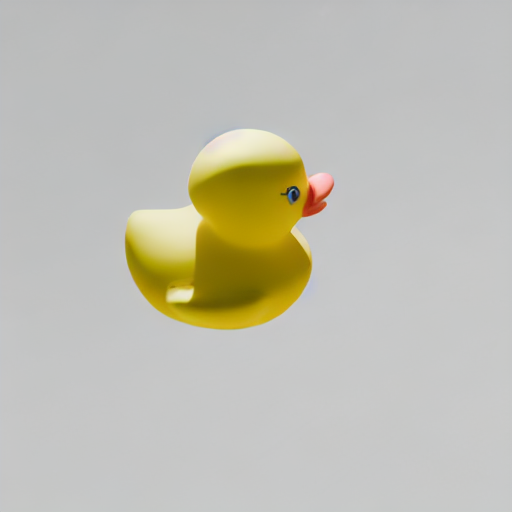

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Front Left Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'front</w>', 'left</w>', 'top</w>']


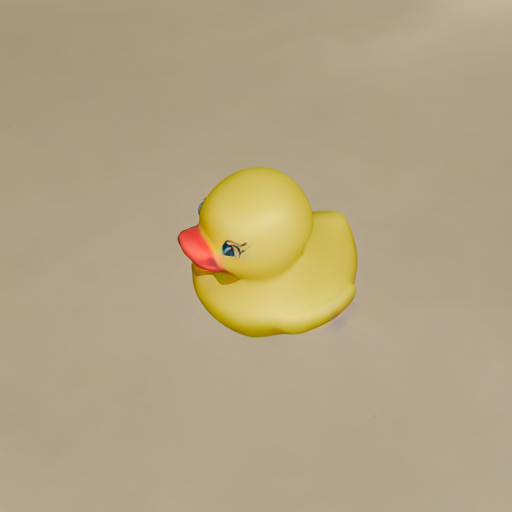

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Front Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'front</w>', 'top</w>']


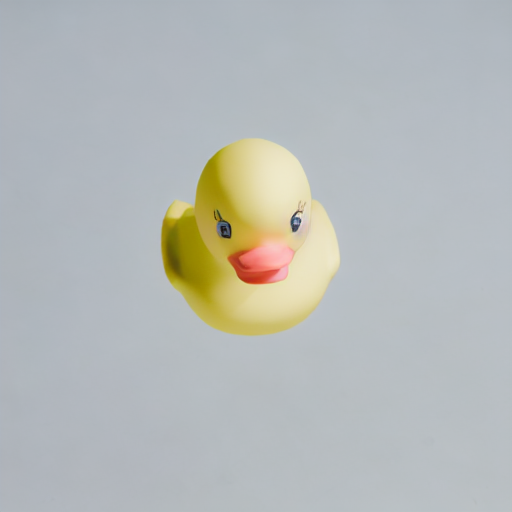

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Front Right Top
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'front</w>', 'right</w>', 'top</w>']


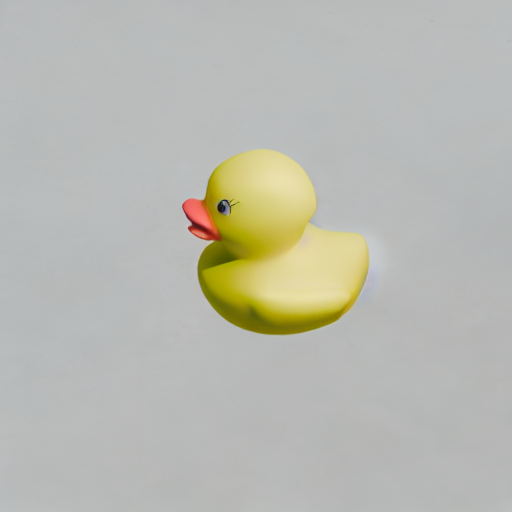

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'right</w>']


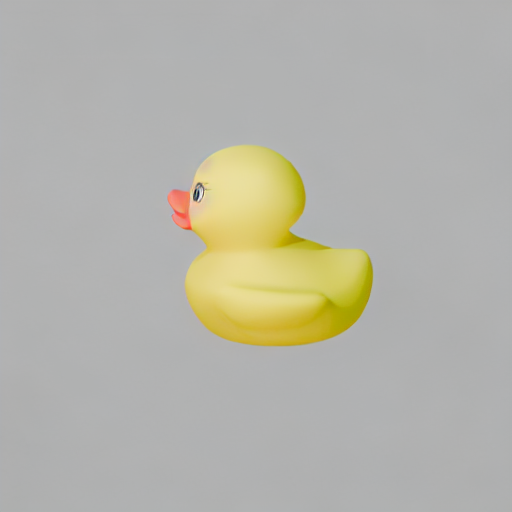

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Back Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'back</w>', 'right</w>']


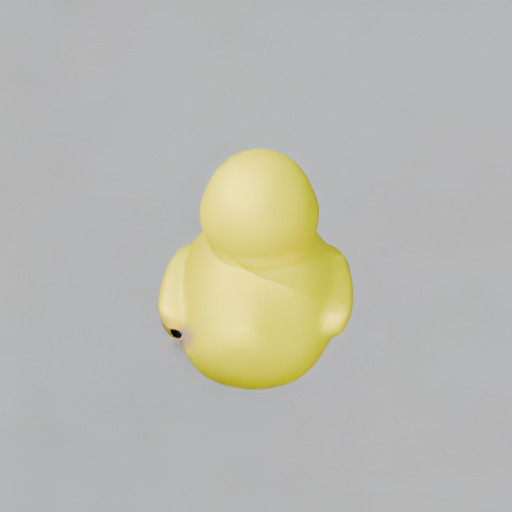

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Back
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'back</w>']


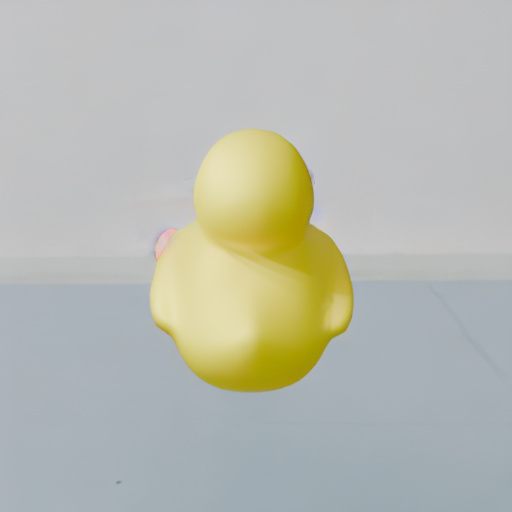

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Back Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'back</w>', 'left</w>']


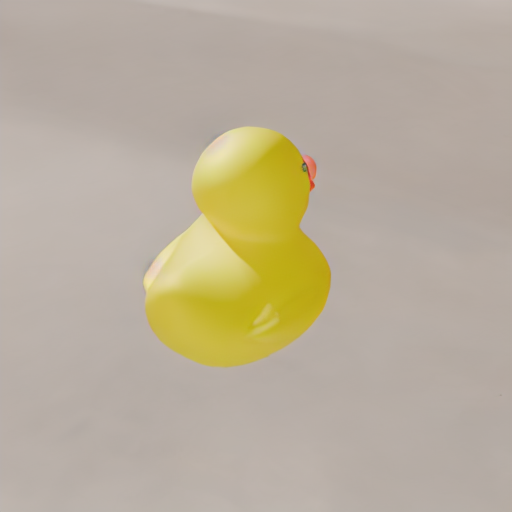

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'left</w>']


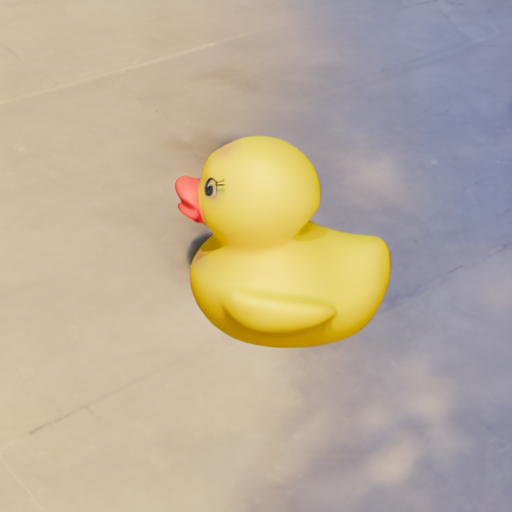

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Front Left
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'front</w>', 'left</w>']


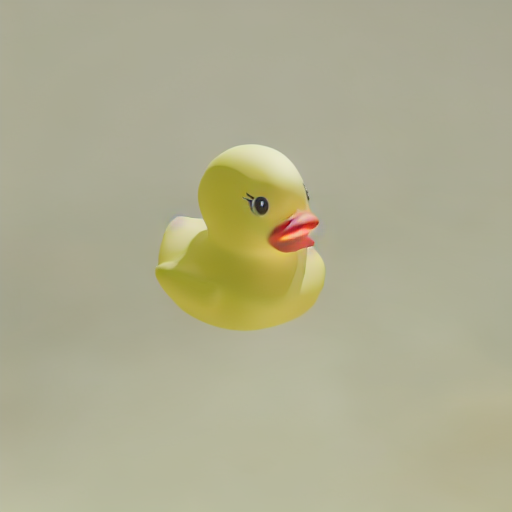

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Front
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'front</w>']


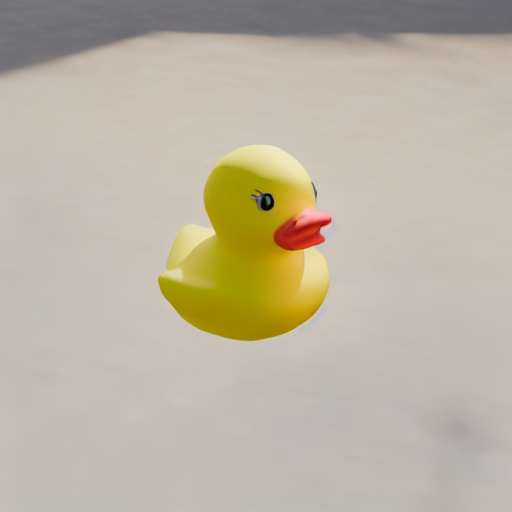

  0%|          | 0/50 [00:00<?, ?it/s]

an image of a yellow rubber duck seen from Front Right
['an</w>', 'image</w>', 'of</w>', 'a</w>', 'yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', 'front</w>', 'right</w>']


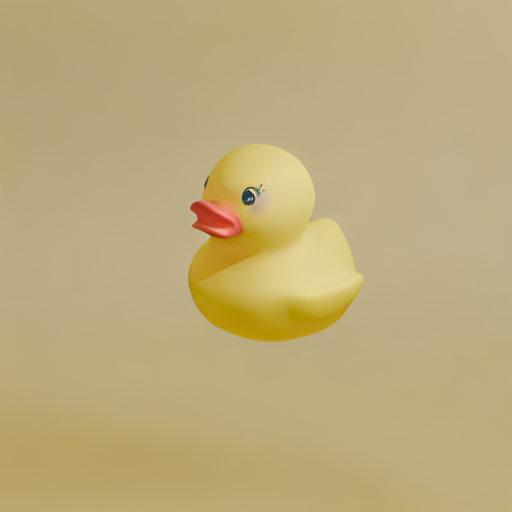

In [9]:
model_path="AdrianoC/RubberDuckProspectStableDiffusion_1_5"
pipe = load_model(model_path, True)
render_all_list(pipe)

## TOKENS model (the left is the left seen from the prospective of the object)
dataset used: https://huggingface.co/datasets/AdrianoC/rubber_duck_extended_tokens

In [4]:
prospective = ["<top>", 
"<back>",
"<front>",
"<right>",
"<left>",
"<front_left_top>",
"<front_right_top>",
"<back_right_top>",
"<back_left_top>",
"<left_top>",
"<right_top>",
"<front_top>",
"<front_right>",
"<front_left>",
"<back_right>",
"<back_top>",
"<back_left>"]

def render_all_list(pipe):
    for perspective in prospective:
        prompt = f"yellow rubber duck seen from  {perspective}"
        render(pipe, prompt, init_image_path)

### 120 epochs

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

yellow rubber duck seen from  <top>
['yellow</w>', 'rubber</w>', 'duck</w>', 'seen</w>', 'from</w>', '<top>']


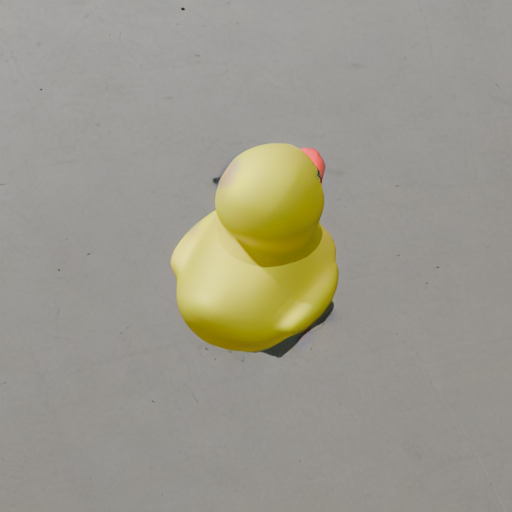

  0%|          | 0/50 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [5]:
model_path="AdrianoC/RubberDuckProspectStableDiffusion_1_5_tokens"
pipe = load_model(model_path, True)
render_all_list(pipe)